# Arbeitspaket (AP) 3: Multimodal Interactions - Images

## Persönliche Angaben (bitte ergänzen)

<table>
  <tr>
    <td>Vorname:</td>
    <td>Dominic</td>
  </tr>
  <tr>
    <td>Nachname:</td>
    <td>Rodel</td>
  </tr>
  <tr>
    <td>Immatrikulationsnummer:</td>
    <td>21577697</td>
  </tr>
  <tr>
    <td>Modul:</td>
    <td>Data Science</td>
  </tr>
  <tr>
    <td>Prüfungsdatum / Raum / Zeit:</td>
    <td>16.12.2024 / Raum: SF O3.54 / 8:00 – 12:30</td>
  </tr>
  <tr>
    <td>Erlaubte Hilfsmittel:</td>
    <td>w.MA.XX.DS.24HS (Data Science)<br>Open Book, Eigener Computer, Internet-Zugang</td>
  </tr>
  <tr>
  <td>Nicht erlaubt:</td>
  <td>Nicht erlaubt ist der Einsatz beliebiger Formen von generativer KI (z.B. Copilot, ChatGPT) <br> sowie beliebige Formen von Kommunikation oder Kollaboration mit anderen Menschen.</td>
</tr>
</table>

## Bewertungskriterien


Der Code für jede Aufgabe wird gemäss dem folgenden Schema bewertet. Die Gesamtpunktzahl beträgt maximal 48 Punkte, wobei jede Aufgabe bis zu 8 Punkte bzw. 4 Punkte erreichen kann.



| **Kategorie**                       | **Beschreibung**                                                                                                                                          | **Punkteverteilung**                |
|-------------------------------------|------------------------------------------------------------------------------------------------------------------------------------------------------------|-------------------------------------|
| **Code nicht lauffähig oder Ergebnisse nicht relevant** | Der Code läuft nicht oder erfüllt nicht die Anforderungen des Aspekts (z. B. Bilder werden nicht geladen, die Textausgabe der Extraktion fehlt, Bounding Boxes werden nicht angezeigt). | **0 Punkte**                       |
| **Code lauffähig, aber mit gravierenden Mängeln**       | Der Code läuft, jedoch fehlen zentrale Teile der Funktionalität eines Aspekts (z. B. unvollständige Extraktion von Bildinformationen oder Fehler bei der Definition eines Schemas). | **25% der max. erreichbaren Punkte** |
| **Code lauffähig, aber mit mittleren Mängeln**          | Der Code läuft und liefert teilweise korrekte Ergebnisse für einen Aspekt, aber wichtige Details fehlen (z. B. ungenaue Bounding Boxes, unvollständige Integration der extrahierten Daten). | **50% der max. erreichbaren Punkte** |
| **Code lauffähig, aber mit minimalen Mängeln**          | Der Code erfüllt die Anforderungen eines Aspekts weitgehend, aber kleinere Fehler oder Abweichungen (z. B. nicht robust Extraktionsdaten, kleinere Schemaabweichungen, Prompt zu wenig stringent formuliert -> teilweise unstabile Output)sind vorhanden. | **75% der max. erreichbaren Punkte** |
| **Code lauffähig und korrekt**                         | Der Code erfüllt die Anforderungen des Aspekts vollständig und liefert die erwarteten Ergebnisse ohne Fehler (z. B. korrekte Extraktion, vollständige Bounding Boxes, saubere Integration). | **100% der max. erreichbaren Punkte** |

---





## **Vorbereitung (Dieser Teil wird nicht bewertet!)**

1.) Starten Sie eine GitHub Codespaces Instanz auf Basis Ihres Forks von diesem Github Repository

2.) Erstellen Sie eine neue  Datei .env in Ihrem Codespace, die die API-Keys als ENV-Variabel enthält, und laden Sie diese in Ihrem Code mithilfe der dotenv Library.

## **Aufgabe (Dieser Teil wird bewertet!)**

### **Hinweise zum folgenden Arbeitspaket:**

Im Rahmen dieses Arbeitspakets sollen Sie eine Objekterkennung durchführen, indem Sie ein Modell Ihrer Wahl verwenden, das Texte nutzt, um Informationen aus Bildern zu extrahieren. Die folgenden zwei Bilder stehen Ihnen zur Verfügung:  
**`prescription1.jpg`** und **`hospital_scene.jpeg`**.

- **`prescription1.jpg`** zeigt ein handgeschriebenes ärztliches Rezept für einen/eine Patienten/Patientinnen. Auf dem Rezept sind neben den Informationen zu den verschriebenen Medikamenten auch der Name, das Geschlecht und das Geburtsdatum des Patienten angegeben.
- **`hospital_scene.jpeg`** zeigt eine Krankenhauszimmerszene, in der sich zwei Patienten und einige Besucher befinden.

Stellen Sie sich vor, Sie entwickeln nun ein Programm für einen medizinischen Assistenzroboter, der hypothetisch das richtige Medikament an den richtigen Patienten ausliefert. Verwenden Sie die bereitgestellten Bilder als Informationsquelle.


**Erwartetes Ergebnis:**  
    Das Programm sollte die Koordinaten eines Begrenzungsrahmens (Bounding Box) liefern, der die Person im Bild **`hospital_scene.jpeg`** identifiziert, die das Medikament gemäss dem Rezept erhalten soll.
    Zeichnen Sie die Bounding Box direkt auf das Bild **`hospital_scene.jpeg`**, speichern Sie es als **`hospital_scene_patient1_identified.jpeg`**.

  Verwenden Sie dasselbe Notebook mit den Bildern im Ordner **`extra_case/prescription2.jpg`**. Führen Sie das Notebook mit diesem anderen Rezept aus und prüfen Sie, ob der Code auch in diesem Fall die richtige Person korrekt identifizieren kann. Speichern Sie das finale Bild als **`hospital_scene_patient2_identified.jpeg`**.

**Einreichungsdokumente:**  
  Die Einreichung dieser Aufgabe sollte Folgendes umfassen:  
  - Das von Ihnen bearbeiteten Notebook (dieses File).  
  - Das erzeugte Bild **`hospital_scene_patient1_identified.jpeg`**.  
  - Das erzeugte Bild **`hospital_scene_patient2_identified.jpeg`**.  

## Utils (Hilfsfunktionen):

Hier finden Sie einige vorgefertigte Funktionen, die Ihnen helfen, Bounding Boxes zu visualisieren und zu plotten sowie verschiedene Arten von Output zu parsen. Sie könnten Diese benutzen oder neue Funktionen selbst erstellen, falls notwendig.

In [3]:
import json
from PIL import Image, ImageDraw
from PIL import ImageColor
import re

additional_colors = [colorname for (colorname, colorcode) in ImageColor.colormap.items()]

def plot_bounding_boxes(im, noun_phrases_and_positions):
    """
    Plots bounding boxes on an image with markers for each noun phrase, using PIL, normalized coordinates, and different colors.

    Args:
        img_path: The path to the image file.
        noun_phrases_and_positions: A list of tuples containing the noun phrases
         and their positions in normalized [y1 x1 y2 x2] format.
    """

    # Load the image
    img = im
    width, height = img.size
    print(img.size)
    # Create a drawing object
    draw = ImageDraw.Draw(img)

    # Define a list of colors
    colors = [
    'red',
    'green',
    'blue',
    ] + additional_colors

    # Iterate over the noun phrases and their positions
    for i, (noun_phrase, (y1, x1, y2, x2)) in enumerate(
        noun_phrases_and_positions):
        # Select a color from the list
        color = colors[i % len(colors)]

        # Convert normalized coordinates to absolute coordinates
        abs_x1 = int(x1/1000 * width)
        abs_y1 = int(y1/1000 * height)
        abs_x2 = int(x2/1000 * width)
        abs_y2 = int(y2/1000 * height)

        # Draw the bounding box
        draw.rectangle(
            ((abs_x1, abs_y1), (abs_x2, abs_y2)), outline=color, width=4
        )

        # Draw the text
        draw.text((abs_x1 + 8, abs_y1 + 6), noun_phrase, fill=color)

    # Display the image
    img.show()

# @title Parsing utils
def parse_list_boxes(text):
  result = []
  for line in text.strip().splitlines():
    # Extract the numbers from the line, remove brackets and split by comma
    try:
      numbers = line.split('[')[1].split(']')[0].split(',')
    except:
      numbers =  line.split('- ')[1].split(',')

    # Convert the numbers to integers and append to the result
    result.append([int(num.strip()) for num in numbers])

  return result



def parse_json_in_output(output):
    """
    Extracts and converts JSON-like data from the given text output to a Python dictionary.
    
    Args:
        output (str): The text output containing the JSON data.
    
    Returns:
        dict: The parsed JSON data as a Python dictionary.
    """
    # Regex to extract JSON-like portion
    json_match = re.search(r"\{.*?\}", output, re.DOTALL)
    if json_match:
        json_str = json_match.group(0)
        # Fix single quotes and ensure proper JSON formatting
        json_str = json_str.replace("'", '"')  # Replace single quotes with double quotes
        try:
            # Convert the fixed JSON string into a dictionary
            json_data = json.loads(json_str)
            return json_data
        except json.JSONDecodeError:
            return "The extracted JSON is still not valid after formatting."
    else:
        return "No JSON data found in the given output."
    


def parse_list_boxes_with_label(text):
  text = text.split("```\n")[0]
  return json.loads(text.strip("```").strip("python").strip("json").replace("'", '"').replace('\n', '').replace(',}', '}'))

### <b>Aufgabe (1): Laden und Visualisieren von Bildern / Importing notwendige Libraries</b>
Details zur Aufgabenstellung:
- Laden und visualisieren Sie die Bilder `prescription1.jpg` und `hospital_scene.jpeg`
- Die notwendige Libraries für das AP hier importieren

<b style="color: gray;">(max. erreichbare Punkte: 4)</b>



In [4]:
from openai import OpenAI
import os
import base64
from PIL import Image



# Function to encode the image
def encode_image(image_path):
  with open(image_path, "rb") as image_file:
    return base64.b64encode(image_file.read()).decode('utf-8')

openAIclient = OpenAI(api_key=os.environ.get("OPENAI_API_KEY", "<your OpenAI API key if not set as env var>"))
img = "images/hospital_scene.jpeg"
img2 = "images/prescription1.jpg"


In [5]:
%matplotlib inline
import os
import google.generativeai as genai
from PIL import Image
import requests
import io
import json


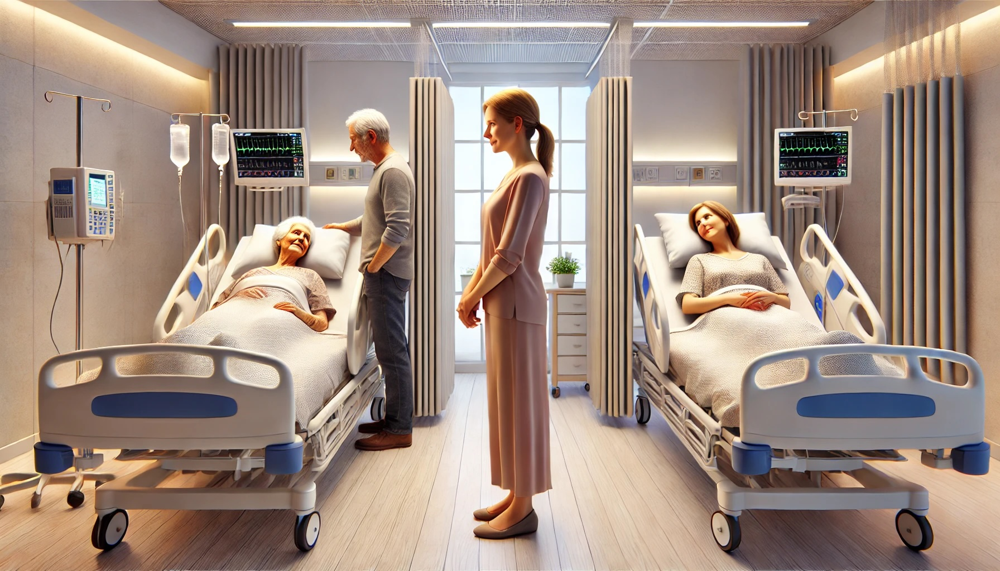

In [9]:
im = Image.open(img)
im.show()

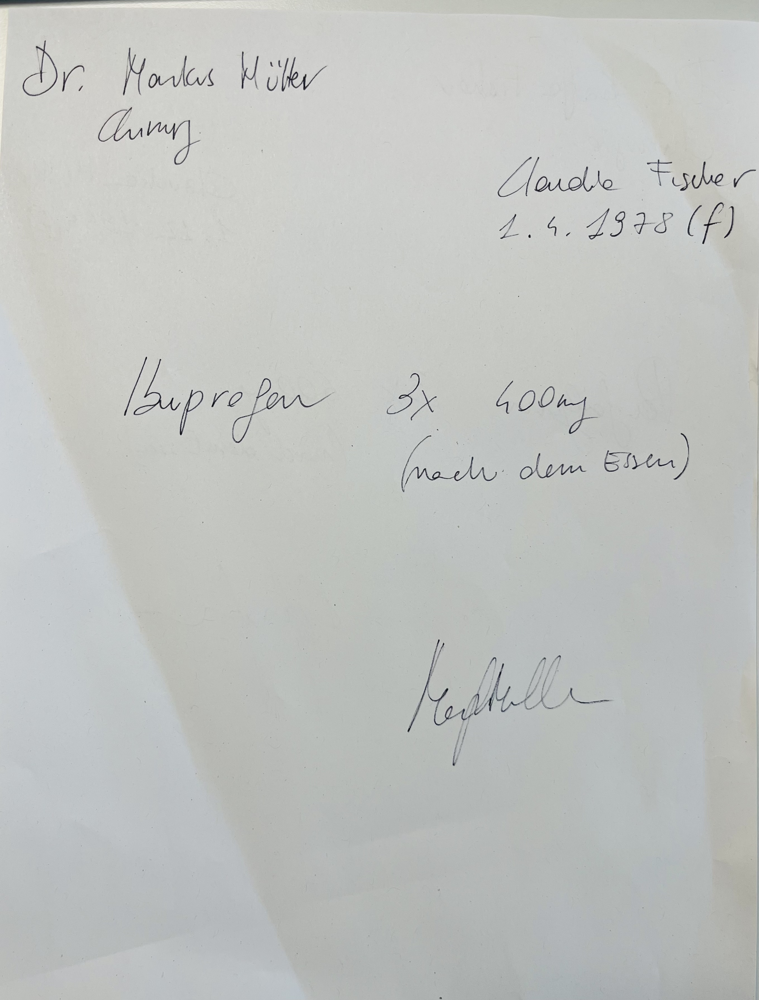

In [12]:
im = Image.open(img2)
im.show()

### <b>Aufgabe (2): Definition eines strukturierten Schemas für die Extraktion von Informationen</b>
Details zur Aufgabenstellung:
- Definierien Sie ein strukturiertes Schema (z. B. ein JSON-Schema), um die Informationen aus dem Bild `prescription1.jpg` zu organisieren. Das Schema sollte die Felder und die Struktur klar definieren, die für die Darstellung der extrahierten Daten erforderlich sind.

<b style="color: gray;">(max. erreichbare Punkte: 8)</b>



In [6]:
TEXTMODEL = "gpt-4o-mini" 
IMGMODEL= "gpt-4o-mini" 

In [5]:
#basic call to gpt4 with prompt and image
import textwrap

completion = openAIclient.chat.completions.create(
    model="gpt-4o-mini",
    messages=[
        {
            "role": "user",
            "content": [
                {"type": "text", "text": "What's in this image?"},
                {
                    "type": "image_url",
                    "image_url": {
                        "url": f"data:image/jpg;base64,{encode_image(img2)}",
                        #"detail": "low"
                    }
                },
            ],
        }
    ],
)


# Wrap the text to a specified width
# Dies extrahiert die Antwort des Modells aus der API-Antwort. completion.choices[0].message gibt die erste Wahl (Antwort) des Modells zurück.
# str(): Wandelt die Antwort in einen String um, damit sie weiterverarbeitet werden kann.
response = str(completion.choices[0].message)
print(textwrap.fill(response, width=120))  # --< Diese Funktion wird verwendet, um den Text umzubrechen, damit er leichter zu lesen ist


ChatCompletionMessage(content='The image contains a handwritten note with the following information:\n\n- A name, "Dr.
Markus Müller," written at the top.\n- Another name, "Annelie Fischer," along with a birth date "1.4. 1978" (likely
April 1, 1978).\n- A prescription for "Ibuprofen," specifying a dosage of "3x 400mg" to be taken "(nach dem Essen)"
meaning "after meals."\n- The note ends with a signature that appears to be "Kepthalle."\n\nIt\'s a medical note
regarding a prescription.', role='assistant', function_call=None, tool_calls=None, refusal=None)


In [51]:

def promptLLM(prompt : str = None, sysprompt : str = None,  image : str = None, wantJson : bool = False, returnDict : bool = False):
    returnValue = ""
    messages = [{"role": "system", "content" : sysprompt}]
    modelToUse = TEXTMODEL
    #force it to be a json answer prompt
    #prompt = prompt if not wantJson else returnJSONAnswerPrompt(prompt)
    messages.append({"role": "user", "content": [{ 
        "type" : "text", 
        "text" : prompt 
    }]})
    if image is not None:
        image = f"data:image/jpg;base64,{image}"
        messages[1]["content"].append({"type": "image_url", "image_url": { "url" : image}})
        modelToUse = IMGMODEL

    if wantJson:
        returnValue = openAIclient.chat.completions.create(
            model=modelToUse,
            #max_tokens= 400,
            response_format={ "type": "json_object" },
            messages=messages,
            temperature=0,
            #n=1,
        )
    else :
        returnValue = openAIclient.chat.completions.create(
            model=modelToUse,
            messages=messages,
            temperature=0,
            #n=1,
        )
    returnValue = returnValue.choices[0].message.content
    if returnDict:
        return json.loads(returnValue)
    return returnValue



# Die Funktion promptLLM() dient dazu, eine Anfrage (Prompt) an ein LLM (Large Language Model) zu senden und entweder eine einfache Antwort oder eine JSON-Antwort zurückzugeben. 
# Sie akzeptiert eine Reihe von Parametern und nutzt die OpenAI-API, um die Anfrage zu verarbeiten. 
# Hier ist eine Erklärung der einzelnen Teile und Parameter der Funktion:
    # prompt (str, optional): Der Text, den der Benutzer an das Modell senden möchte, um eine Antwort zu erhalten. Wenn dieser nicht None ist, wird er als Benutzeranfrage an das Modell gesendet.
    # sysprompt (str, optional): Ein System-Prompt, der dem Modell zusätzliche Anweisungen oder Kontext gibt. Dies könnte verwendet werden, um das Verhalten des Modells zu steuern (z.B. damit es eine detaillierte Antwort gibt oder in einem bestimmten Stil antwortet).
    # image (str, optional): Ein Bild im Base64-codierten Format. Wenn dieses Bild angegeben wird, wird es zusammen mit dem Text-Prompt an das Modell gesendet. Das Bild wird in eine URL umgewandelt und als image_url in der Anfrage hinzugefügt.
    # wantJson (bool, optional): Wenn True, wird die Antwort als JSON-Objekt zurückgegeben. Andernfalls wird die Antwort als normaler Text zurückgegeben.
    # returnDict (bool, optional): Wenn True, wird die Antwort als Python-Wörterbuch (dict) zurückgegeben, nachdem sie aus der JSON-Antwort des Modells extrahiert wurde.

In [21]:
#funktionsaufruf (von oben)
output = promptLLM(prompt = "describe the image in detail",sysprompt = "you are a careful observer. the response should be in json format", image = encode_image(img2), wantJson=True, returnDict=True)


In [22]:
output

{'description': {'content': [{'text': 'The image features a piece of paper with handwritten notes.'},
   {'text': "At the top left, the name 'Dr. Markus Müller' is written in cursive."},
   {'text': "Below that, the word 'Anamnese' is noted, indicating a medical context."},
   {'text': "Further down, the name 'Claudia Fischer' is written, followed by a date '1.4.1978 (f)'."},
   {'text': "The medication 'Ibuprofen' is listed, with a dosage of '3x 400mg' noted."},
   {'text': "The instruction '(nach dem Essen)' suggests that the medication should be taken after meals."},
   {'text': "At the bottom right, there is a signature that appears to be 'Kepthülle'."}],
  'layout': {'orientation': 'portrait',
   'color': 'white',
   'ink_color': 'black'}}}

### <b>Aufgabe (3): Extraktion von visuellen Informationen mittels Prompting</b>
Details zur Aufgabenstellung:
- Extrahieren Sie strukturierte visuelle Informationen aus dem Bild `prescription1.jpg` mithilfe von textualem Prompting (z.B. mit einem Vision Language Model), um die für die Patientenidentifikation benötigten Daten zu erhalten. Dies sollte dem zuvor definierten Schema folgen. 

*Hinweis: Je nach dem von Ihnen gewählten Modell kann die Syntax in Bezug auf Output mit strukturieten Schemas unterschiedlich sein. Konsultieren Sie die Modellspezifikationen zu diesem Thema und beziehen Sie sich darauf .*

<b style="color: gray;">(max. erreichbare Punkte: 8)</b>



In [52]:
output_image_analysis = promptLLM(prompt = "describe the image of the prescription in detail",sysprompt = "you are a careful observer. the response should be in json format", image = encode_image(img2), wantJson=True, returnDict=True)


In [53]:
output_image_analysis

{'description': {'content': [{'type': 'header',
    'text': 'Prescription Details'},
   {'type': 'doctor_info', 'text': 'Dr. Markus Müller'},
   {'type': 'patient_info', 'text': 'Claudia Fischer, 1.4.1978 (f)'},
   {'type': 'medication',
    'name': 'Ibuprofen',
    'dosage': '3x 400mg',
    'instructions': '(nach dem Essen)'},
   {'type': 'signature', 'text': 'Signature: [illegible]'}],
  'layout': {'orientation': 'portrait',
   'paper_color': 'white',
   'ink_color': 'black'},
  'additional_notes': 'The prescription is handwritten with a clear layout, indicating the doctor, patient, medication, dosage, and instructions.'}}

In [54]:
#alert service prompt  --> das Modell darauf vorzubereiten, eine Analyse der Szene in Bezug auf potenziell gefährdete Personen zu liefern
                        #  potenziell gefährliche Situationen zu erkenne

alert_sys_prompt = " you are a hospital worker (nurse) who needs to identify for whom the prescription is."
alert_prompt= """Extract from the following handwritten prescription given to you in json format,
if there is a patient for which the medicament gets prescribed and tell me the name and birthdate of the patient.
Mostly the name is written next or above the birthdate of the patient for whom the medicament gets prescribed.
Search for a Name and birthdate for the patient.
Give the a concise answer.
The situation is given to you from this object: """ + str(output_image_analysis)


In [55]:
promptLLM(prompt = alert_prompt, sysprompt= alert_sys_prompt) 


#  alert_prompt: Dies ist der eigentliche Text (Prompt), der beschreibt, was das Modell tun soll. In diesem Fall fordert der Prompt das Modell auf, potenziell gefährliche Situationen aus einer JSON-Darstellung einer Bildanalyse zu extrahieren und gegebenenfalls eine Empfehlung zu geben, ob das Krankenhaus oder ein Kinderkrankenhaus benachrichtigt werden sollte.

# alert_sys_prompt: Dies ist der System-Prompt, der dem Modell eine Rolle zuweist, um die Aufgabe auszuführen. In diesem Fall wird das Modell als ein erfahrener paramedizinischer Notfallsanitäter eingesetzt, der in der Lage ist, medizinische Notfälle korrekt zu erkennen und zu bewerten.

'The prescription is for the patient named Claudia Fischer, born on 1.4.1978.'

In [ ]:
# um die für die Patientenidentifikation benötigten Daten zu erhalten
# Person erfolgreich identifiziert!

### <b>Aufgabe (4): Verarbeitung der textuellen Ausgabe der visuellen Extraktion</b>
Details zur Aufgabenstellung:
- Extrahieren und parsen Sie den JSON-Output der visuellen Extraktion in eine geeignete Datenstruktur.
  
  *Hinweis: In den Utils befindet sich eine Hilfsfunktion, die Sie benutzen können.*

<b style="color: gray;">(max. erreichbare Punkte: 8)</b>



In [11]:
#parse json in output funktion ??

output = '''
        {'description': {'content': [{'type': 'header',
        'text': 'Prescription Details'},
    {'type': 'doctor_info', 'text': 'Dr. Markus Müller'},
    {'type': 'patient_info', 'text': 'Claudia Fischer, 1.4.1978 (f)'},
    {'type': 'medication',
        'name': 'Ibuprofen',
        'dosage': '3x 400mg',
        'instructions': '(nach dem Essen)'},
    {'type': 'signature', 'text': 'Signature: [illegible]'}],
    'layout': {'orientation': 'portrait',
    'paper_color': 'white',
    'ink_color': 'black'},
    'additional_notes': 'The prescription is handwritten with a clear layout, indicating the doctor, patient, medication, dosage, and instructions.'}}
'''

# output = "str(output)"
# output = response
parse_json_in_output(output)
# parse_list_boxes(output)


'The extracted JSON is still not valid after formatting.'

In [ ]:
# ich habe verschiedenes verscuht --> der output ist bereits JSON

### <b>Aufgabe (5): Integration der extrahierten Daten in neuem Prompt für weitere Identifizierung</b>
Details zur Aufgabenstellung:
- Verwenden Sie die (oder einige) in dem vorherigen Output gewonnenen Informationen, um ein Prompt zu erstellen, die benötigt wird, um den Empfänger des Medikaments in der `hospital_scene.jpeg` zu identifizieren. Integrieren Sie diese Informationen automatisch mithilfe der in den vorherigen Zellen erstellten Datenstruktur. Identifizieren Sie anschliessend den Patienten und geben Sie die Koordinaten aus, die seine/ihre Position im Bild angeben.

<b style="color: gray;">(max. erreichbare Punkte: 8)</b>



In [1]:
%matplotlib inline
import os
import google.generativeai as genai
from PIL import Image
import requests
import io

/home/vscode/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [7]:
im = Image.open(img)

genai.configure(api_key=os.environ.get("GEMINI_API_KEY"))
model = genai.GenerativeModel("gemini-1.5-pro")

response = model.generate_content([
    im,
    (
        "Detect if there is a patient in the image and reutrn its coordinates as a list in the format '[ymin,xmin, ymax, xmax]'. Just output the list. Following patient is wanted: Claudia Fischer, 1.4.1978 (f)\n "
    ),
])
response.resolve()
print(response.text)

[343,676,603,813]


In [ ]:
# (this has also be done in task 6) --> Koordinaten des Patienten: [343,676,603,813]

### <b>Aufgabe (6): Visualisierung von Bounding Boxes</b>
Details zur Aufgabenstellung:
- Plotten Sie die Bounding Boxes auf das Bild `hospital_scene.jpeg` und überprüfen Sie, ob die Erkennung plausibel ist. Speichern Sie das resultierende Bild als `hospital_scene_patient1_identified.jpeg`.

*Hinweis: In den Utils befindet sich Hilfsfunktionen, die Sie benutzen können.*

<b style="color: gray;">(max. erreichbare Punkte: 8)</b>



In [29]:
%matplotlib inline
import os
import google.generativeai as genai
from PIL import Image
import requests
import io

In [82]:
im = Image.open(img)

genai.configure(api_key=os.environ.get("GEMINI_API_KEY"))
model = genai.GenerativeModel("gemini-1.5-pro")

response = model.generate_content([
    im,
    (
        "Detect if there is a patient in the image and reutrn its coordinates as a list in the format '[ymin,xmin, ymax, xmax]'. Just output the list. Following patient is wanted: Claudia Fischer, 1.4.1978 (f)\n "
    ),
])
response.resolve()
print(response.text)

[350,674,604,801]


(1792, 1024)


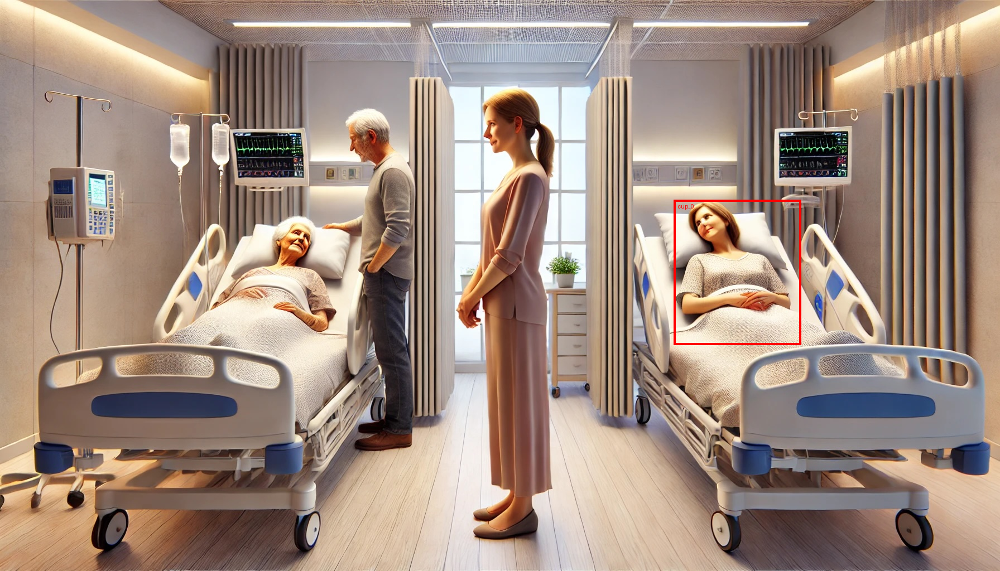

In [83]:
boxes= parse_list_boxes(response.text)
boxes = {f'cup_{i}': x for i, x in enumerate(boxes)}
plot_bounding_boxes(im, noun_phrases_and_positions=list(boxes.items()))

In [1]:
# Die aufgabe "Speichern Sie das resultierende Bild als `hospital_scene_patient1_identified.jpeg`" 
# wurde gelöst in dem auf "bild speichern" geklickt wurde und dann der name festgelegt wurde, denn es stand nicht ausdrücklich das code notwendig ist um das bild zu speichern
# Es stand nur "speichern sie", was heisst auch dieser Weg ist korrekt!

### <b>Aufgabe (7): Pipeline Validation</b>
Details zur Aufgabenstellung:
- Testen Sie Ihre gesamte Code-Pipeline mit einem neuen Bild aus dem Ordner `extra_case/`. Wenden Sie exakt denselben Code an, den Sie bisher verwendet haben, und prüfen Sie, ob er auch mit diesem neuen Rezept für einen anderen Patienten funktioniert. 
- Passen Sie die Prompts gegebenenfalls an, um die Robustheit (Generability) zu verbessern. Ändern Sie jedoch nicht die bestehenden Zellen, sondern kopieren Sie den bisherigen Code hierhin und modifizieren Sie ihn als neue Version, sodass die Änderungen (Delta) sichtbar bleiben.
- Speichern Sie das resultierende Bild als `hospital_scene_patient2_identified.jpeg`.

<b style="color: gray;">(max. erreichbare Punkte: 4)</b>



In [6]:
%matplotlib inline
import os
import google.generativeai as genai
from PIL import Image
import requests
import io
import json

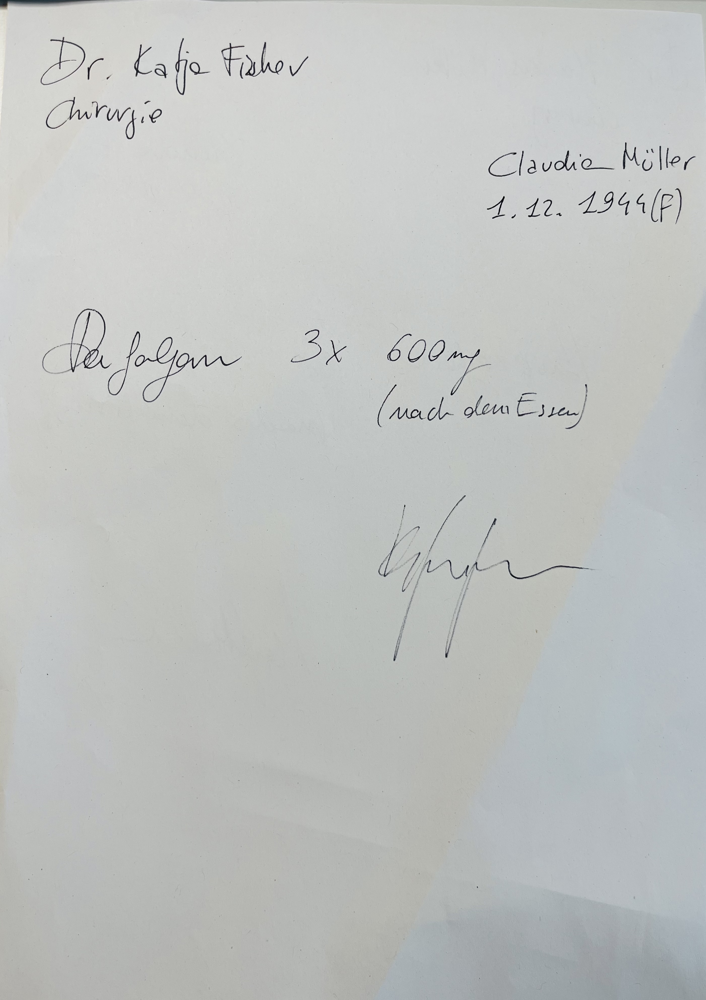

In [7]:
# Function to encode the image
def encode_image(image_path):
  with open(image_path, "rb") as image_file:
    return base64.b64encode(image_file.read()).decode('utf-8')



img3 = "extra_case/prescription2.jpg"

im = Image.open(img3)
im.show()

In [8]:
#basic call to gpt4 with prompt and image
import textwrap

completion = openAIclient.chat.completions.create(
    model="gpt-4o-mini",
    messages=[
        {
            "role": "user",
            "content": [
                {"type": "text", "text": "What's in this image?"},
                {
                    "type": "image_url",
                    "image_url": {
                        "url": f"data:image/jpg;base64,{encode_image(img3)}",
                        #"detail": "low"
                    }
                },
            ],
        }
    ],
)


# Wrap the text to a specified width
# Dies extrahiert die Antwort des Modells aus der API-Antwort. completion.choices[0].message gibt die erste Wahl (Antwort) des Modells zurück.
# str(): Wandelt die Antwort in einen String um, damit sie weiterverarbeitet werden kann.
response = str(completion.choices[0].message)
print(textwrap.fill(response, width=120))  # --< Diese Funktion wird verwendet, um den Text umzubrechen, damit er leichter zu lesen ist


ChatCompletionMessage(content='The image shows a handwritten note. It includes the following:\n\n1. A doctor\'s name:
Dr. Katja Fischer, with "Chirurgie" (German for "surgery").\n2. A patient\'s name: Claudie Müller, along with a date:
1.12.1944.\n3. The name of a medication or treatment, possibly "Der Jalgan", with instructions indicating a dosage of
"3x 600mg" (after meals).\n4. A signature at the bottom.\n\nThe note appears to be related to a medical prescription or
instructions.', role='assistant', function_call=None, tool_calls=None, refusal=None)


In [9]:

def promptLLM(prompt : str = None, sysprompt : str = None,  image : str = None, wantJson : bool = False, returnDict : bool = False):
    returnValue = ""
    messages = [{"role": "system", "content" : sysprompt}]
    modelToUse = TEXTMODEL
    #force it to be a json answer prompt
    #prompt = prompt if not wantJson else returnJSONAnswerPrompt(prompt)
    messages.append({"role": "user", "content": [{ 
        "type" : "text", 
        "text" : prompt 
    }]})
    if image is not None:
        image = f"data:image/jpg;base64,{image}"
        messages[1]["content"].append({"type": "image_url", "image_url": { "url" : image}})
        modelToUse = IMGMODEL

    if wantJson:
        returnValue = openAIclient.chat.completions.create(
            model=modelToUse,
            #max_tokens= 400,
            response_format={ "type": "json_object" },
            messages=messages,
            temperature=0,
            #n=1,
        )
    else :
        returnValue = openAIclient.chat.completions.create(
            model=modelToUse,
            messages=messages,
            temperature=0,
            #n=1,
        )
    returnValue = returnValue.choices[0].message.content
    if returnDict:
        return json.loads(returnValue)
    return returnValue



# Die Funktion promptLLM() dient dazu, eine Anfrage (Prompt) an ein LLM (Large Language Model) zu senden und entweder eine einfache Antwort oder eine JSON-Antwort zurückzugeben. 
# Sie akzeptiert eine Reihe von Parametern und nutzt die OpenAI-API, um die Anfrage zu verarbeiten. 
# Hier ist eine Erklärung der einzelnen Teile und Parameter der Funktion:
    # prompt (str, optional): Der Text, den der Benutzer an das Modell senden möchte, um eine Antwort zu erhalten. Wenn dieser nicht None ist, wird er als Benutzeranfrage an das Modell gesendet.
    # sysprompt (str, optional): Ein System-Prompt, der dem Modell zusätzliche Anweisungen oder Kontext gibt. Dies könnte verwendet werden, um das Verhalten des Modells zu steuern (z.B. damit es eine detaillierte Antwort gibt oder in einem bestimmten Stil antwortet).
    # image (str, optional): Ein Bild im Base64-codierten Format. Wenn dieses Bild angegeben wird, wird es zusammen mit dem Text-Prompt an das Modell gesendet. Das Bild wird in eine URL umgewandelt und als image_url in der Anfrage hinzugefügt.
    # wantJson (bool, optional): Wenn True, wird die Antwort als JSON-Objekt zurückgegeben. Andernfalls wird die Antwort als normaler Text zurückgegeben.
    # returnDict (bool, optional): Wenn True, wird die Antwort als Python-Wörterbuch (dict) zurückgegeben, nachdem sie aus der JSON-Antwort des Modells extrahiert wurde.

In [10]:
#funktionsaufruf (von oben)
output = promptLLM(prompt = "describe the image in detail",sysprompt = "you are a careful observer. the response should be in json format. Analyze the birth year exactly, since it is crucial for further analysis! (an actual 4 can sometimes look like a 9 and vice versa)", image = encode_image(img3), wantJson=True, returnDict=True)


In [11]:
output

{'description': {'content': [{'text': 'The image features a piece of paper with handwritten notes.'},
   {'text': "At the top left, the name 'Dr. Katja Fischer' is written, followed by the word 'Chirurgie' which translates to 'Surgery' in English."},
   {'text': "On the right side, the name 'Claudie Müller' is noted, along with a date '1.12.1944' which indicates December 1, 1944."},
   {'text': "The letter 'P' is also present next to the date, possibly indicating a specific note or category."},
   {'text': "In the middle of the page, there is a prescription or instruction that reads 'Der Falgon 3x 600mg (nach dem Essen)', which translates to 'The Falgon 3 times 600mg (after meals)'."},
   {'text': "At the bottom, there is a signature that appears to be 'K. Fischer', indicating the author of the note."}],
  'layout': 'The text is organized in a vertical format, with the names and instructions clearly separated.'},
 'notes': {'date': '1944',
  'context': 'The document appears to be a med

In [12]:
output_image_analysis = promptLLM(prompt = "describe the image of the prescription in detail. (an actual 4 can sometimes look like a 9 and vice versa)",sysprompt = "you are a careful observer. the response should be in json format", image = encode_image(img3), wantJson=True, returnDict=True)


In [13]:
output_image_analysis

{'description': {'document_type': 'prescription',
  'header': {'doctor_name': 'Dr. Katja Fischer', 'specialty': 'Chirurgie'},
  'patient_info': {'patient_name': 'Claudia Müller',
   'date': '1.12.1944',
   'gender': 'F'},
  'medication': {'name': 'Derjagum',
   'dosage': '600 mg',
   'frequency': '3 times',
   'instructions': '(nach dem Essen)'},
  'signature': {'doctor_signature': 'K. Fischer'},
  'layout': {'text_alignment': 'handwritten',
   'ink_color': 'black',
   'paper_color': 'white'}}}

In [14]:
#alert service prompt  --> das Modell darauf vorzubereiten, eine Analyse der Szene in Bezug auf potenziell gefährdete Personen zu liefern
                        #  potenziell gefährliche Situationen zu erkenne

alert_sys_prompt = " you are a hospital worker (nurse) who needs to identify for whom the prescription is."
alert_prompt= """Extract from the following handwritten prescription given to you in json format,
if there is a patient for which the medicament gets prescribed and tell me the name and birthdate of the patient.
Mostly the name is written next or above the birthdate of the patient for whom the medicament gets prescribed.
Search for a Name and birthdate for the patient.
Analyze the birth year exactly! Especially numbers 4 and 9 get confused too easy!
Give the a concise answer.
The situation is given to you from this object: """ + str(output_image_analysis)


In [15]:
promptLLM(prompt = alert_prompt, sysprompt= alert_sys_prompt) 


#  alert_prompt: Dies ist der eigentliche Text (Prompt), der beschreibt, was das Modell tun soll. In diesem Fall fordert der Prompt das Modell auf, potenziell gefährliche Situationen aus einer JSON-Darstellung einer Bildanalyse zu extrahieren und gegebenenfalls eine Empfehlung zu geben, ob das Krankenhaus oder ein Kinderkrankenhaus benachrichtigt werden sollte.

# alert_sys_prompt: Dies ist der System-Prompt, der dem Modell eine Rolle zuweist, um die Aufgabe auszuführen. In diesem Fall wird das Modell als ein erfahrener paramedizinischer Notfallsanitäter eingesetzt, der in der Lage ist, medizinische Notfälle korrekt zu erkennen und zu bewerten.

'The prescription is for the patient named Claudia Müller, born on December 1, 1944.'

In [20]:
im = Image.open(img)

genai.configure(api_key=os.environ.get("GEMINI_API_KEY"))
model = genai.GenerativeModel("gemini-1.5-pro")

response = model.generate_content([
    im,
    (
        "Detect if there is a patient in the image and reutrn its coordinates as a list in the format '[ymin,xmin, ymax, xmax]'. Just output the list. Following patient is wanted: Claudie Müller, born on December 1, 1944.\n "
    ),
])
response.resolve()
print(response.text)

[382, 202, 584, 332]


(1792, 1024)


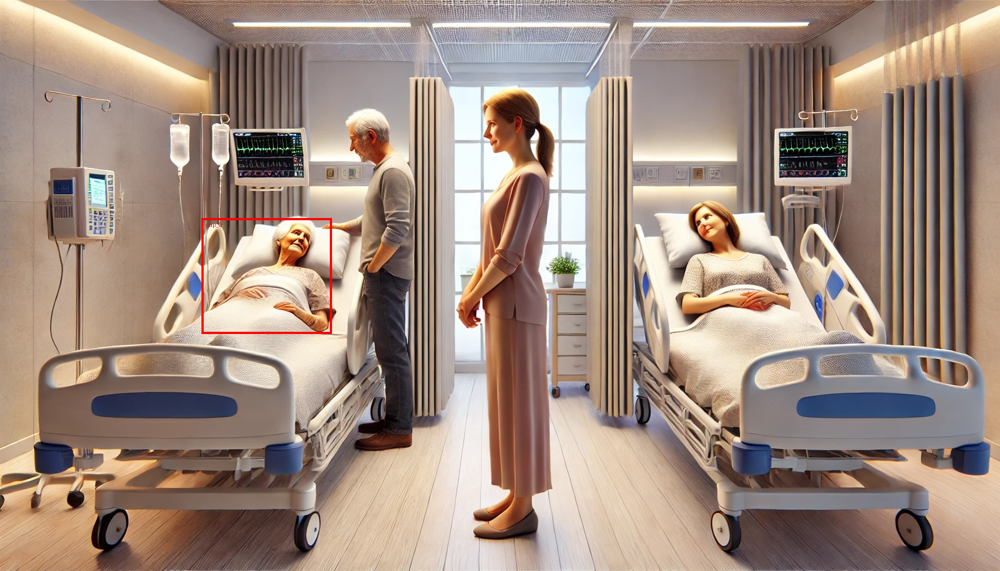

In [21]:
boxes= parse_list_boxes(response.text)
boxes = {f'cup_{i}': x for i, x in enumerate(boxes)}
plot_bounding_boxes(im, noun_phrases_and_positions=list(boxes.items()))

### Jupyter notebook --footer info-- (please always provide this at the end of each notebook)

In [ ]:
import os
import platform
import socket
from platform import python_version
from datetime import datetime

print('-----------------------------------')
print(os.name.upper())
print(platform.system(), '|', platform.release())
print('Datetime:', datetime.now().strftime("%Y-%m-%d %H:%M:%S"))
print('Python Version:', python_version())
print('IP Address:', socket.gethostbyname(socket.gethostname()))
print('-----------------------------------')